In [3]:
# Standard libraries
import xarray as xr
import numpy as np
import pandas as pd
import os
import glob
import cartopy.crs as ccrs
import cartopy.feature as cfeature
import matplotlib.pyplot as plt
%matplotlib inline
from cartopy.mpl.gridliner import LONGITUDE_FORMATTER, LATITUDE_FORMATTER
import seaborn as sns
import iris
from iris.pandas import as_cubes
import sys

from datetime import datetime
from cartopy.util import add_cyclic_point
import gc
import imageio.v2
from IPython import display
# import netCDF4
from global_land_mask import globe
# # Import tobac itself:
import tobac

# Disable a few warnings:
import warnings
warnings.filterwarnings('ignore', category=UserWarning, append=True)
warnings.filterwarnings('ignore', category=RuntimeWarning, append=True)
warnings.filterwarnings('ignore', category=FutureWarning, append=True)
warnings.filterwarnings('ignore', category=pd.io.pytables.PerformanceWarning)

In [2]:
%%time
path = '/glade/u/home/noteng/work/research/data/'
file = 'march13-march14.nc'
data = xr.open_dataset(path+file)
data = data.sel(time=slice('2020-03-13T04:00:00.000000000', '2020-03-14T05:00:00.000000000'))
data

CPU times: user 26.7 ms, sys: 11.3 ms, total: 38 ms
Wall time: 346 ms


<xarray.Dataset>
Dimensions:                         (time: 301, Xc: 2067, Yc: 2243)
Coordinates:
  * time                            (time) datetime64[ns] 2020-03-13T04:00:00...
  * Xc                              (Xc) float32 -5.33e+05 ... 1.533e+06
  * Yc                              (Yc) float32 -1.81e+06 ... -4.052e+06
    lon                             (Yc, Xc) float32 ...
    lat                             (Yc, Xc) float32 ...
Data variables: (12/14)
    projection_lambert              (time) int32 ...
    mosaic_info                     (time) int32 ...
    equivalent_reflectivity_factor  (time, Yc, Xc) float32 ...
    is_nodata                       (time, Yc, Xc) int8 ...
    is_lowele                       (time, Yc, Xc) int8 ...
    is_highele                      (time, Yc, Xc) int8 ...
    ...                              ...
    is_seaclutter                   (time, Yc, Xc) int8 ...
    is_groundclutter                (time, Yc, Xc) int8 ...
    is_otherclutter                 (time, Yc, Xc) int8 ...
    clutter_probability             (time, Yc, Xc) int8 ...
    classification                  (time, Yc, Xc) int8 ...
    is_convective                   (time, Yc, Xc) int8 ...

In [3]:
# equivalent_reflectivity_factor = data['equivalent_reflectivity_factor'][:,450:580,256:771] #Based on longitude and latitude of Andoya and Norwegian Sea
equivalent_reflectivity_factor = data['equivalent_reflectivity_factor'][:,250:650,450:850] #Based on longitude and latitude of Andoya and Norwegian Sea
# equivalent_reflectivity_factor = data['equivalent_reflectivity_factor'][:,330:580,660:780] #### hdm1 and hdm2
# equivalent_reflectivity_factor = data['equivalent_reflectivity_factor']
equivalent_reflectivity_factor

<xarray.DataArray 'equivalent_reflectivity_factor' (time: 301, Yc: 400, Xc: 400)>
[48160000 values with dtype=float32]
Coordinates:
  * time     (time) datetime64[ns] 2020-03-13T04:00:00 ... 2020-03-14T05:00:00
  * Xc       (Xc) float32 -8.3e+04 -8.2e+04 -8.1e+04 ... 3.15e+05 3.16e+05
  * Yc       (Yc) float32 -2.06e+06 -2.061e+06 ... -2.458e+06 -2.459e+06
    lon      (Yc, Xc) float32 ...
    lat      (Yc, Xc) float32 ...
Attributes:
    standard_name:  equivalent_reflectivity_factor
    long_name:      Radar Reflectivity
    units:          dBZ
    grid_mapping:   projection_lambert

In [4]:
# load Mask_ERF_files
Mask_ERF = iris.load('../saved-files/threshold-all/Mask_ERF_iris-all.nc')[0]
Mask_ERF

<iris 'Cube' of segmentation_mask / (1) (time: 301; -- : 400; -- : 400)>

In [5]:
track = pd.read_csv('../saved-files/threshold-all/track-reset-all.csv')
track.head()

,frame,idx,hdim_1,hdim_2,num,threshold_value,feature,time,timestr,projection_y_coordinate,projection_x_coordinate,latitude,longitude,cell,time_cell
0,0,1,84.600598,399.000000,4,10,1,2020-03-13 04:00:00,2020-03-13 04:00:00,-2.144601e+06,316000.000000,70.490523,18.382036,1,0 days 00:00:00
1,0,2,101.255095,389.000000,5,10,2,2020-03-13 04:00:00,2020-03-13 04:00:00,-2.161255e+06,306000.000000,70.353605,18.058626,2,0 days 00:00:00
2,1,2,104.000000,390.000000,1,10,154,2020-03-13 04:05:00,2020-03-13 04:05:00,-2.164000e+06,307000.000000,70.327606,18.074493,2,0 days 00:05:00
3,0,4,112.472423,381.827530,14,10,3,2020-03-13 04:00:00,2020-03-13 04:00:00,-2.172472e+06,298827.530189,70.261556,17.831991,3,0 days 00:00:00
4,1,4,113.727184,383.443874,16,10,155,2020-03-13 04:05:00,2020-03-13 04:05:00,-2.173727e+06,300443.873660,70.248236,17.869335,3,0 days 00:05:00


### calcuating distance

In [6]:
distance = []
for i in range(len(track)):
    lat_andenes = 69.141281 # latitude of Andenes
    # lat_andenes = 69.2412 # latiude of the radar
    lon_andenes = 15.684166 # latitude of Andenes
    # lon_andenes = 16.0030 # longitude of where the radar is located

    
    distances = tobac.analysis.haversine(track['latitude'][i], track['longitude'][i], lat_andenes, lon_andenes)
    distance.append(distances)

In [7]:
distance[:10]

[182.43437543707546,
 163.0197162726861,
 161.0141146049329,
 149.7509707609343,
 149.34336642103662,
 149.24182495055717,
 148.61234140991726,
 147.93938503740355,
 141.41145656289183,
 139.97711810611716]

In [8]:
%%time
# apped distance to track dataframe
track['distance'] = pd.Series(distance)

CPU times: user 5.51 ms, sys: 36 µs, total: 5.54 ms
Wall time: 5.55 ms


In [9]:
# # 5km distance from the AMF1-site
# track = track[track['distance'] <= 20]
# track.head()

## _cells that lived for at least 10 mins old and less than 20 km long_  

In [10]:
# %%time
# # cell_one_hour = np.timedelta64( 600, 's') #10 minutes in seconds
# cell_times = np.timedelta64( 600, 's') #10 minutes in seconds

# #convert time_cell to seconds
# time_cell = track['time_cell'].astype('timedelta64[ns]').values

# # track cell that live for at least 10 minutes long
# track_close_to_AMF1 = track[ time_cell >= cell_times ]
# # track_close_to_AMF1 = track[ ((track['distance'] <= 95) & (track['time_cell'].values >= cell_one_hour)) ]
# track_close_to_AMF1= track_close_to_AMF1.drop_duplicates(subset=['cell']) # remove duplicates of cell_ids
# track_close_to_AMF1.head()

In [11]:
%%time
# cell_one_hour = np.timedelta64( 600, 's') #10 minutes in seconds
cell_times = np.timedelta64( 600, 's') #10 minutes in seconds

#convert time_cell to seconds
time_cell = track['time_cell'].astype('timedelta64[ns]').values

# track cell that live for at least 10 minutes long and was less than 20km
# track_close_to_AMF1 = track[ time_cell >= cell_times ]
track_close_to_AMF1 = track[ (time_cell >= cell_times) & (track['distance'] <= 20) ]
# # track_close_to_AMF1 = track[ ((track['distance'] <= 95) & (track['time_cell'].values >= cell_one_hour)) ]
track_close_to_AMF1= track_close_to_AMF1.drop_duplicates(subset=['cell']) # remove duplicates of cell_ids
track_close_to_AMF1.head()

CPU times: user 72.6 ms, sys: 0 ns, total: 72.6 ms
Wall time: 78.2 ms


,frame,idx,hdim_1,hdim_2,num,threshold_value,feature,time,timestr,projection_y_coordinate,projection_x_coordinate,latitude,longitude,cell,time_cell,distance
542,4,45,252.997935,318.049114,31,10,636,2020-03-13 04:20:00,2020-03-13 04:20:00,-2.312998e+06,235049.113796,69.059589,15.802534,300,0 days 00:10:00,10.236632
1025,6,47,263.000000,310.000000,1,10,952,2020-03-13 04:30:00,2020-03-13 04:30:00,-2.323000e+06,227000.000000,68.976128,15.581136,484,0 days 00:10:00,18.835839
1153,10,51,244.323857,292.386688,8,10,1595,2020-03-13 04:50:00,2020-03-13 04:50:00,-2.304324e+06,209386.687718,69.160704,15.192030,527,0 days 00:25:00,19.617153
2400,14,154,238.164707,322.864324,5,15,2334,2020-03-13 05:10:00,2020-03-13 05:10:00,-2.298165e+06,239864.323620,69.189591,15.958508,975,0 days 00:10:00,12.120200
2656,16,164,257.961832,313.409819,5,15,2700,2020-03-13 05:20:00,2020-03-13 05:20:00,-2.317962e+06,230409.818658,69.018791,15.676662,1075,0 days 00:10:00,13.638451


In [12]:
# total track cells found.
len(track_close_to_AMF1) 

73

# tracking all cells that were at least 10 minutes old and less than 20km long back in time to get all the cells

In [13]:
%%time
combined_tracks_AMF1 = []
for index, cell_id in enumerate(np.unique(track_close_to_AMF1['cell'].values)): # looped through tracks found with AMF1 site
    if cell_id in track['cell']: # checking if those cells(tracks) are within the original tracked dataframe
        print(f'cell {cell_id} available')
        track_i = track[track['cell'] == cell_id] # display it if it is within the tracked dataframe
        combined_tracks_AMF1.append(track_i) # append the results you get a new dataFrame calld combined_tracks_AMF1

# Concatenate the dataframes(combined_tracks_AMD) along the rows axis with keys
# tracks_closer_AMF1 = pd.concat(combined_tracks_AMF1, keys=['df1', 'df2', 'df3', 'df4', 'df5', 'df6'])
tracks_closer_AMF1 = pd.concat(combined_tracks_AMF1)
tracks_closer_AMF1

cell 300 available
cell 484 available
cell 527 available
cell 975 available
cell 1075 available
cell 2678 available
cell 2962 available
cell 3017 available
cell 3192 available
cell 3275 available
cell 3580 available
cell 3855 available
cell 3892 available
cell 3943 available
cell 4023 available
cell 4094 available
cell 4276 available
cell 4293 available
cell 4401 available
cell 4520 available
cell 4657 available
cell 4744 available
cell 4838 available
cell 4964 available
cell 4980 available
cell 5004 available
cell 5362 available
cell 5572 available
cell 5668 available
cell 5872 available
cell 5903 available
cell 6065 available
cell 6140 available
cell 6334 available
cell 6479 available
cell 6501 available
cell 6514 available
cell 6722 available
cell 7320 available
cell 7556 available
cell 7727 available
cell 7797 available
cell 7803 available
cell 7864 available
cell 7909 available
cell 7963 available
cell 8223 available
cell 8255 available
cell 8257 available
cell 8463 available
cell

,frame,idx,hdim_1,hdim_2,num,threshold_value,feature,time,timestr,projection_y_coordinate,projection_x_coordinate,latitude,longitude,cell,time_cell,distance
540,2,45,246.000000,316.000000,1,10,338,2020-03-13 04:10:00,2020-03-13 04:10:00,-2.306000e+06,233000.000000,69.124939,15.769628,300,0 days 00:00:00,3.846052
541,3,39,250.423362,318.045479,30,10,485,2020-03-13 04:15:00,2020-03-13 04:15:00,-2.310423e+06,235045.479327,69.082940,15.808867,300,0 days 00:05:00,8.165263
542,4,45,252.997935,318.049114,31,10,636,2020-03-13 04:20:00,2020-03-13 04:20:00,-2.312998e+06,235049.113796,69.059589,15.802534,300,0 days 00:10:00,10.236632
543,5,42,256.659677,317.628840,10,10,794,2020-03-13 04:25:00,2020-03-13 04:25:00,-2.316660e+06,234628.840468,69.026764,15.783137,300,0 days 00:15:00,13.340686
1023,4,141,258.000000,311.520986,2,15,691,2020-03-13 04:20:00,2020-03-13 04:20:00,-2.318000e+06,228520.986323,69.020142,15.630334,484,0 days 00:00:00,13.653535
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
35281,294,103,250.110072,313.566052,15,20,35190,2020-03-14 04:30:00,2020-03-14 04:30:00,-2.310110e+06,230566.052076,69.089877,15.699666,12209,0 days 00:10:00,5.755132
35282,295,109,251.005761,315.328807,6,20,35252,2020-03-14 04:35:00,2020-03-14 04:35:00,-2.311006e+06,232328.807120,69.080152,15.740741,12209,0 days 00:15:00,7.165638
35283,296,100,252.693252,318.328393,6,20,35311,2020-03-14 04:40:00,2020-03-14 04:40:00,-2.312693e+06,235328.393297,69.062096,15.810142,12209,0 days 00:20:00,10.135141
35284,297,105,253.000000,320.452780,2,20,35371,2020-03-14 04:45:00,2020-03-14 04:45:00,-2.313000e+06,237452.779832,69.057341,15.861456,12209,0 days 00:25:00,11.699560


In [14]:
# resetting the index
tracks_closer_AMF1_index_reset = tracks_closer_AMF1.reset_index(drop=True)
tracks_closer_AMF1_index_reset.head()

,frame,idx,hdim_1,hdim_2,num,threshold_value,feature,time,timestr,projection_y_coordinate,projection_x_coordinate,latitude,longitude,cell,time_cell,distance
0,2,45,246.000000,316.000000,1,10,338,2020-03-13 04:10:00,2020-03-13 04:10:00,-2.306000e+06,233000.000000,69.124939,15.769628,300,0 days 00:00:00,3.846052
1,3,39,250.423362,318.045479,30,10,485,2020-03-13 04:15:00,2020-03-13 04:15:00,-2.310423e+06,235045.479327,69.082940,15.808867,300,0 days 00:05:00,8.165263
2,4,45,252.997935,318.049114,31,10,636,2020-03-13 04:20:00,2020-03-13 04:20:00,-2.312998e+06,235049.113796,69.059589,15.802534,300,0 days 00:10:00,10.236632
3,5,42,256.659677,317.628840,10,10,794,2020-03-13 04:25:00,2020-03-13 04:25:00,-2.316660e+06,234628.840468,69.026764,15.783137,300,0 days 00:15:00,13.340686
4,4,141,258.000000,311.520986,2,15,691,2020-03-13 04:20:00,2020-03-13 04:20:00,-2.318000e+06,228520.986323,69.020142,15.630334,484,0 days 00:00:00,13.653535


# Algorithm to calculate the corresponding reflectivity values (calculate for the max and mean dBZ) and the area

In [15]:
unique_cell_ids = track_close_to_AMF1['cell'].values # getting the cells_tracked
len(unique_cell_ids)

73

In [16]:
%%time
# all masked cell in iris cube
masked_tracked_cell = []
for i, unique_value in enumerate(unique_cell_ids):
    # get masked cell based on cell id
    get_mask_cell = tobac.utils.mask_cell(mask=Mask_ERF, cell=unique_value, track=track, masked=False) 
    masked_tracked_cell.append(get_mask_cell)

CPU times: user 188 ms, sys: 0 ns, total: 188 ms
Wall time: 188 ms


In [17]:
masked_tracked_cell[:10]

[<iris 'Cube' of segmentation_mask / (1) (time: 301; -- : 400; -- : 400)>,
 <iris 'Cube' of segmentation_mask / (1) (time: 301; -- : 400; -- : 400)>,
 <iris 'Cube' of segmentation_mask / (1) (time: 301; -- : 400; -- : 400)>,
 <iris 'Cube' of segmentation_mask / (1) (time: 301; -- : 400; -- : 400)>,
 <iris 'Cube' of segmentation_mask / (1) (time: 301; -- : 400; -- : 400)>,
 <iris 'Cube' of segmentation_mask / (1) (time: 301; -- : 400; -- : 400)>,
 <iris 'Cube' of segmentation_mask / (1) (time: 301; -- : 400; -- : 400)>,
 <iris 'Cube' of segmentation_mask / (1) (time: 301; -- : 400; -- : 400)>,
 <iris 'Cube' of segmentation_mask / (1) (time: 301; -- : 400; -- : 400)>,
 <iris 'Cube' of segmentation_mask / (1) (time: 301; -- : 400; -- : 400)>]

In [19]:
%%time
# Convert the segmented/mask cells from iris cube to xrray
masked_values_to_xarray = []
for i, items in enumerate(masked_tracked_cell):
    mask_convert_xr = xr.DataArray.from_iris(masked_tracked_cell[i]) # convert iris cube to xarray data array
    masked_values_to_xarray.append(mask_convert_xr) # append the results to list
    # print(mask_convert_xr)

CPU times: user 178 ms, sys: 2.98 ms, total: 181 ms
Wall time: 181 ms


In [20]:
%%time
# Getting the original masked reflectivity values
slice_cell_times = []
for i, cell_id in enumerate(np.unique(tracks_closer_AMF1['cell'])):
    cell_ids = tracks_closer_AMF1_index_reset[tracks_closer_AMF1_index_reset['cell'] == cell_id] 
    first_time = cell_ids['timestr'][::].values[0] # get first time (start time)
    last_time = cell_ids['timestr'][::-1].values[0]  # get the last time value (end time)
    # slice values based on time
    slice_cell_time = masked_values_to_xarray[i].sel(time=slice(first_time, last_time))
    slice_cell_times.append(slice_cell_time)
    # print(slice_cell_time)

CPU times: user 117 ms, sys: 97 µs, total: 117 ms
Wall time: 121 ms


In [21]:
%%time
equivalent_reflectivity_factors = 10**((equivalent_reflectivity_factor/10))
# equivalent_reflectivity_factors = 10*np.log10(Z)

CPU times: user 4.33 s, sys: 435 ms, total: 4.76 s
Wall time: 4.99 s


## algorithm to extract the speed, area, maximum, minimum and mean reflectivity values based on cell_id and specific times

In [22]:
%%time
min_reflectivities = []; mean_reflectivities = []; max_reflectivities = []; areas = [];
for i, cell_id in enumerate(np.unique(tracks_closer_AMF1['cell'])):
    #################################
    import warnings
    warnings.filterwarnings('ignore')
    #################################
    cell_ids = tracks_closer_AMF1_index_reset[tracks_closer_AMF1_index_reset['cell'] == cell_id]  # dataframe based on cell_id
    first_time = cell_ids['timestr'][::].values[0] # get first time (start time)
    last_time = cell_ids['timestr'][::-1].values[0]  # get the last time value (end time)
    
#     # # # # Calculating area
    # area = tobac.analysis.calculate_area(track, Mask_ERF)
#     # area = tobac.analysis.calculate_area(cell_ids, masked_tracked_cell[i], method_area=None)
#     area = np.absolute(area['area']/1000000) # area in kilometers
#     areas.append(area)
    
    # area1 = np.divide(area['area'],1000000)
    # area['area($km^2$)'] = area1


    # reflectivity_masked based on times
    reflectivity_masked = equivalent_reflectivity_factors.sel(time=slice(first_time, last_time))
    
    # LOOPING THROUGH THE AND GETTING THE VALUES
    for index in (range(len(reflectivity_masked))):
        mean_ref = reflectivity_masked[index].mean().item() # get mean values of reflectivity # in dBZ values
        # # Convert from dBZ to Z values
        # mean_ref_Z = 10**(mean_ref / 10)
        # # Convert it back to dBZ units
        # mean_ref_dBZ = 10*np.log10(mean_ref_Z)
        #####################################
        max_ref = reflectivity_masked[index].max().item() # get max values of reflectivity
        
        mean_reflectivities.append(mean_ref)
        max_reflectivities.append(max_ref)
        
# concatenate the area values to one series
# area1 = pd.concat(areas)

# calculate velocity
# velocity = tobac.analysis.calculate_velocity(tracks_closer_AMF1_index_reset)

CPU times: user 774 ms, sys: 994 µs, total: 775 ms
Wall time: 782 ms


In [23]:
# converting the mean Z unit back to dBZ
mean_reflectivities1 = 10*np.log10(mean_reflectivities)

# converting the max Z unit back to dBZ
max_reflectivities1 = 10*np.log10(max_reflectivities)

In [24]:
np.min(mean_reflectivities1), np.max(mean_reflectivities1)

(12.70891348332567, 17.00984974968715)

In [25]:
tracks_closer_AMF1_index_reset

,frame,idx,hdim_1,hdim_2,num,threshold_value,feature,time,timestr,projection_y_coordinate,projection_x_coordinate,latitude,longitude,cell,time_cell,distance
0,2,45,246.000000,316.000000,1,10,338,2020-03-13 04:10:00,2020-03-13 04:10:00,-2.306000e+06,233000.000000,69.124939,15.769628,300,0 days 00:00:00,3.846052
1,3,39,250.423362,318.045479,30,10,485,2020-03-13 04:15:00,2020-03-13 04:15:00,-2.310423e+06,235045.479327,69.082940,15.808867,300,0 days 00:05:00,8.165263
2,4,45,252.997935,318.049114,31,10,636,2020-03-13 04:20:00,2020-03-13 04:20:00,-2.312998e+06,235049.113796,69.059589,15.802534,300,0 days 00:10:00,10.236632
3,5,42,256.659677,317.628840,10,10,794,2020-03-13 04:25:00,2020-03-13 04:25:00,-2.316660e+06,234628.840468,69.026764,15.783137,300,0 days 00:15:00,13.340686
4,4,141,258.000000,311.520986,2,15,691,2020-03-13 04:20:00,2020-03-13 04:20:00,-2.318000e+06,228520.986323,69.020142,15.630334,484,0 days 00:00:00,13.653535
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
447,294,103,250.110072,313.566052,15,20,35190,2020-03-14 04:30:00,2020-03-14 04:30:00,-2.310110e+06,230566.052076,69.089877,15.699666,12209,0 days 00:10:00,5.755132
448,295,109,251.005761,315.328807,6,20,35252,2020-03-14 04:35:00,2020-03-14 04:35:00,-2.311006e+06,232328.807120,69.080152,15.740741,12209,0 days 00:15:00,7.165638
449,296,100,252.693252,318.328393,6,20,35311,2020-03-14 04:40:00,2020-03-14 04:40:00,-2.312693e+06,235328.393297,69.062096,15.810142,12209,0 days 00:20:00,10.135141
450,297,105,253.000000,320.452780,2,20,35371,2020-03-14 04:45:00,2020-03-14 04:45:00,-2.313000e+06,237452.779832,69.057341,15.861456,12209,0 days 00:25:00,11.699560


In [26]:
# append max min and mean reflectivity values based on each cell id and times to the tracks_closer_AMF1_index_reset dataframe
# tracks_closer_AMF1_index_reset['speed'] = velocity
# tracks_closer_AMF1_index_reset['area1'] = area1
tracks_closer_AMF1_index_reset['mean dBZ'] = pd.Series(mean_reflectivities1)
tracks_closer_AMF1_index_reset['max dBZ'] = pd.Series(max_reflectivities1)

In [27]:
tracks_closer_AMF1_index_reset

,frame,idx,hdim_1,hdim_2,num,threshold_value,feature,time,timestr,projection_y_coordinate,projection_x_coordinate,latitude,longitude,cell,time_cell,distance,mean dBZ,max dBZ
0,2,45,246.000000,316.000000,1,10,338,2020-03-13 04:10:00,2020-03-13 04:10:00,-2.306000e+06,233000.000000,69.124939,15.769628,300,0 days 00:00:00,3.846052,12.780750,34.063904
1,3,39,250.423362,318.045479,30,10,485,2020-03-13 04:15:00,2020-03-13 04:15:00,-2.310423e+06,235045.479327,69.082940,15.808867,300,0 days 00:05:00,8.165263,12.708913,36.584485
2,4,45,252.997935,318.049114,31,10,636,2020-03-13 04:20:00,2020-03-13 04:20:00,-2.312998e+06,235049.113796,69.059589,15.802534,300,0 days 00:10:00,10.236632,12.845599,38.092506
3,5,42,256.659677,317.628840,10,10,794,2020-03-13 04:25:00,2020-03-13 04:25:00,-2.316660e+06,234628.840468,69.026764,15.783137,300,0 days 00:15:00,13.340686,13.138674,36.584485
4,4,141,258.000000,311.520986,2,15,691,2020-03-13 04:20:00,2020-03-13 04:20:00,-2.318000e+06,228520.986323,69.020142,15.630334,484,0 days 00:00:00,13.653535,12.845599,38.092506
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
447,294,103,250.110072,313.566052,15,20,35190,2020-03-14 04:30:00,2020-03-14 04:30:00,-2.310110e+06,230566.052076,69.089877,15.699666,12209,0 days 00:10:00,5.755132,15.196207,39.099655
448,295,109,251.005761,315.328807,6,20,35252,2020-03-14 04:35:00,2020-03-14 04:35:00,-2.311006e+06,232328.807120,69.080152,15.740741,12209,0 days 00:15:00,7.165638,15.270663,40.109338
449,296,100,252.693252,318.328393,6,20,35311,2020-03-14 04:40:00,2020-03-14 04:40:00,-2.312693e+06,235328.393297,69.062096,15.810142,12209,0 days 00:20:00,10.135141,15.390894,40.106802
450,297,105,253.000000,320.452780,2,20,35371,2020-03-14 04:45:00,2020-03-14 04:45:00,-2.313000e+06,237452.779832,69.057341,15.861456,12209,0 days 00:25:00,11.699560,15.206985,38.598690


In [28]:
len(tracks_closer_AMF1_index_reset)

452

## _CALCULATE AREA_

In [30]:
area = tobac.calculate_area(tracks_closer_AMF1_index_reset, Mask_ERF, method_area=None)
# area1 = (c['area']/1000000)
area1 = np.divide(area['area'],1000000)
area['area($km^2$)'] = area1

In [31]:
tracks_closer_AMF1_index_reset

,frame,idx,hdim_1,hdim_2,num,threshold_value,feature,time,timestr,projection_y_coordinate,projection_x_coordinate,latitude,longitude,cell,time_cell,distance,mean dBZ,max dBZ,area,area($km^2$)
0,2,45,246.000000,316.000000,1,10,338,2020-03-13 04:10:00,2020-03-13 04:10:00,-2.306000e+06,233000.000000,69.124939,15.769628,300,0 days 00:00:00,3.846052,12.780750,34.063904,6.964233e+06,6.964233
1,3,39,250.423362,318.045479,30,10,485,2020-03-13 04:15:00,2020-03-13 04:15:00,-2.310423e+06,235045.479327,69.082940,15.808867,300,0 days 00:05:00,8.165263,12.708913,36.584485,3.780959e+07,37.809595
2,4,45,252.997935,318.049114,31,10,636,2020-03-13 04:20:00,2020-03-13 04:20:00,-2.312998e+06,235049.113796,69.059589,15.802534,300,0 days 00:10:00,10.236632,12.845599,38.092506,3.780959e+07,37.809585
3,5,42,256.659677,317.628840,10,10,794,2020-03-13 04:25:00,2020-03-13 04:25:00,-2.316660e+06,234628.840468,69.026764,15.783137,300,0 days 00:15:00,13.340686,13.138674,36.584485,3.482535e+07,34.825352
4,4,141,258.000000,311.520986,2,15,691,2020-03-13 04:20:00,2020-03-13 04:20:00,-2.318000e+06,228520.986323,69.020142,15.630334,484,0 days 00:00:00,13.653535,12.845599,38.092506,6.765845e+07,67.658450
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
447,294,103,250.110072,313.566052,15,20,35190,2020-03-14 04:30:00,2020-03-14 04:30:00,-2.310110e+06,230566.052076,69.089877,15.699666,12209,0 days 00:10:00,5.755132,15.196207,39.099655,1.184047e+08,118.404700
448,295,109,251.005761,315.328807,6,20,35252,2020-03-14 04:35:00,2020-03-14 04:35:00,-2.311006e+06,232328.807120,69.080152,15.740741,12209,0 days 00:15:00,7.165638,15.270663,40.109338,1.184039e+08,118.403926
449,296,100,252.693252,318.328393,6,20,35311,2020-03-14 04:40:00,2020-03-14 04:40:00,-2.312693e+06,235328.393297,69.062096,15.810142,12209,0 days 00:20:00,10.135141,15.390894,40.106802,8.557065e+07,85.570648
450,297,105,253.000000,320.452780,2,20,35371,2020-03-14 04:45:00,2020-03-14 04:45:00,-2.313000e+06,237452.779832,69.057341,15.861456,12209,0 days 00:25:00,11.699560,15.206985,38.598690,1.253648e+08,125.364796


In [32]:
final_tracks_thresh_10 = tracks_closer_AMF1_index_reset.drop(columns=['area'])
final_tracks_thresh_10

,frame,idx,hdim_1,hdim_2,num,threshold_value,feature,time,timestr,projection_y_coordinate,projection_x_coordinate,latitude,longitude,cell,time_cell,distance,mean dBZ,max dBZ,area($km^2$)
0,2,45,246.000000,316.000000,1,10,338,2020-03-13 04:10:00,2020-03-13 04:10:00,-2.306000e+06,233000.000000,69.124939,15.769628,300,0 days 00:00:00,3.846052,12.780750,34.063904,6.964233
1,3,39,250.423362,318.045479,30,10,485,2020-03-13 04:15:00,2020-03-13 04:15:00,-2.310423e+06,235045.479327,69.082940,15.808867,300,0 days 00:05:00,8.165263,12.708913,36.584485,37.809595
2,4,45,252.997935,318.049114,31,10,636,2020-03-13 04:20:00,2020-03-13 04:20:00,-2.312998e+06,235049.113796,69.059589,15.802534,300,0 days 00:10:00,10.236632,12.845599,38.092506,37.809585
3,5,42,256.659677,317.628840,10,10,794,2020-03-13 04:25:00,2020-03-13 04:25:00,-2.316660e+06,234628.840468,69.026764,15.783137,300,0 days 00:15:00,13.340686,13.138674,36.584485,34.825352
4,4,141,258.000000,311.520986,2,15,691,2020-03-13 04:20:00,2020-03-13 04:20:00,-2.318000e+06,228520.986323,69.020142,15.630334,484,0 days 00:00:00,13.653535,12.845599,38.092506,67.658450
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
447,294,103,250.110072,313.566052,15,20,35190,2020-03-14 04:30:00,2020-03-14 04:30:00,-2.310110e+06,230566.052076,69.089877,15.699666,12209,0 days 00:10:00,5.755132,15.196207,39.099655,118.404700
448,295,109,251.005761,315.328807,6,20,35252,2020-03-14 04:35:00,2020-03-14 04:35:00,-2.311006e+06,232328.807120,69.080152,15.740741,12209,0 days 00:15:00,7.165638,15.270663,40.109338,118.403926
449,296,100,252.693252,318.328393,6,20,35311,2020-03-14 04:40:00,2020-03-14 04:40:00,-2.312693e+06,235328.393297,69.062096,15.810142,12209,0 days 00:20:00,10.135141,15.390894,40.106802,85.570648
450,297,105,253.000000,320.452780,2,20,35371,2020-03-14 04:45:00,2020-03-14 04:45:00,-2.313000e+06,237452.779832,69.057341,15.861456,12209,0 days 00:25:00,11.699560,15.206985,38.598690,125.364796


In [33]:
#reset cell_id starting from 1
final_tracks_thresh_10['cloud_id'] = final_tracks_thresh_10.groupby('cell').ngroup() + 1
final_tracks_thresh_10

,frame,idx,hdim_1,hdim_2,num,threshold_value,feature,time,timestr,projection_y_coordinate,projection_x_coordinate,latitude,longitude,cell,time_cell,distance,mean dBZ,max dBZ,area($km^2$),cloud_id
0,2,45,246.000000,316.000000,1,10,338,2020-03-13 04:10:00,2020-03-13 04:10:00,-2.306000e+06,233000.000000,69.124939,15.769628,300,0 days 00:00:00,3.846052,12.780750,34.063904,6.964233,1
1,3,39,250.423362,318.045479,30,10,485,2020-03-13 04:15:00,2020-03-13 04:15:00,-2.310423e+06,235045.479327,69.082940,15.808867,300,0 days 00:05:00,8.165263,12.708913,36.584485,37.809595,1
2,4,45,252.997935,318.049114,31,10,636,2020-03-13 04:20:00,2020-03-13 04:20:00,-2.312998e+06,235049.113796,69.059589,15.802534,300,0 days 00:10:00,10.236632,12.845599,38.092506,37.809585,1
3,5,42,256.659677,317.628840,10,10,794,2020-03-13 04:25:00,2020-03-13 04:25:00,-2.316660e+06,234628.840468,69.026764,15.783137,300,0 days 00:15:00,13.340686,13.138674,36.584485,34.825352,1
4,4,141,258.000000,311.520986,2,15,691,2020-03-13 04:20:00,2020-03-13 04:20:00,-2.318000e+06,228520.986323,69.020142,15.630334,484,0 days 00:00:00,13.653535,12.845599,38.092506,67.658450,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
447,294,103,250.110072,313.566052,15,20,35190,2020-03-14 04:30:00,2020-03-14 04:30:00,-2.310110e+06,230566.052076,69.089877,15.699666,12209,0 days 00:10:00,5.755132,15.196207,39.099655,118.404700,73
448,295,109,251.005761,315.328807,6,20,35252,2020-03-14 04:35:00,2020-03-14 04:35:00,-2.311006e+06,232328.807120,69.080152,15.740741,12209,0 days 00:15:00,7.165638,15.270663,40.109338,118.403926,73
449,296,100,252.693252,318.328393,6,20,35311,2020-03-14 04:40:00,2020-03-14 04:40:00,-2.312693e+06,235328.393297,69.062096,15.810142,12209,0 days 00:20:00,10.135141,15.390894,40.106802,85.570648,73
450,297,105,253.000000,320.452780,2,20,35371,2020-03-14 04:45:00,2020-03-14 04:45:00,-2.313000e+06,237452.779832,69.057341,15.861456,12209,0 days 00:25:00,11.699560,15.206985,38.598690,125.364796,73


In [34]:
final_tracks_thresh_10 = final_tracks_thresh_10.sort_values(by=['timestr', 'time'])
final_tracks_thresh_10

,frame,idx,hdim_1,hdim_2,num,threshold_value,feature,time,timestr,projection_y_coordinate,projection_x_coordinate,latitude,longitude,cell,time_cell,distance,mean dBZ,max dBZ,area($km^2$),cloud_id
0,2,45,246.000000,316.000000,1,10,338,2020-03-13 04:10:00,2020-03-13 04:10:00,-2.306000e+06,233000.000000,69.124939,15.769628,300,0 days 00:00:00,3.846052,12.780750,34.063904,6.964233,1
1,3,39,250.423362,318.045479,30,10,485,2020-03-13 04:15:00,2020-03-13 04:15:00,-2.310423e+06,235045.479327,69.082940,15.808867,300,0 days 00:05:00,8.165263,12.708913,36.584485,37.809595,1
2,4,45,252.997935,318.049114,31,10,636,2020-03-13 04:20:00,2020-03-13 04:20:00,-2.312998e+06,235049.113796,69.059589,15.802534,300,0 days 00:10:00,10.236632,12.845599,38.092506,37.809585,1
4,4,141,258.000000,311.520986,2,15,691,2020-03-13 04:20:00,2020-03-13 04:20:00,-2.318000e+06,228520.986323,69.020142,15.630334,484,0 days 00:00:00,13.653535,12.845599,38.092506,67.658450,2
3,5,42,256.659677,317.628840,10,10,794,2020-03-13 04:25:00,2020-03-13 04:25:00,-2.316660e+06,234628.840468,69.026764,15.783137,300,0 days 00:15:00,13.340686,13.138674,36.584485,34.825352,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
447,294,103,250.110072,313.566052,15,20,35190,2020-03-14 04:30:00,2020-03-14 04:30:00,-2.310110e+06,230566.052076,69.089877,15.699666,12209,0 days 00:10:00,5.755132,15.196207,39.099655,118.404700,73
448,295,109,251.005761,315.328807,6,20,35252,2020-03-14 04:35:00,2020-03-14 04:35:00,-2.311006e+06,232328.807120,69.080152,15.740741,12209,0 days 00:15:00,7.165638,15.270663,40.109338,118.403926,73
449,296,100,252.693252,318.328393,6,20,35311,2020-03-14 04:40:00,2020-03-14 04:40:00,-2.312693e+06,235328.393297,69.062096,15.810142,12209,0 days 00:20:00,10.135141,15.390894,40.106802,85.570648,73
450,297,105,253.000000,320.452780,2,20,35371,2020-03-14 04:45:00,2020-03-14 04:45:00,-2.313000e+06,237452.779832,69.057341,15.861456,12209,0 days 00:25:00,11.699560,15.206985,38.598690,125.364796,73


In [35]:
# all tracks
final_tracks_thresh_10.to_csv('../cells-closer-to-AMF1/saved-files/cells-closer-AMF1_20km-thres-all.csv', index=False)

In [37]:
tracks = pd.read_csv('./saved-files/cells-closer-AMF1_20km-thres-all.csv')
tracks.head()

,frame,idx,hdim_1,hdim_2,num,threshold_value,feature,time,timestr,projection_y_coordinate,projection_x_coordinate,latitude,longitude,cell,time_cell,distance,mean dBZ,max dBZ,area($km^2$),cloud_id
0,2,45,246.000000,316.000000,1,10,338,2020-03-13 04:10:00,2020-03-13 04:10:00,-2.306000e+06,233000.000000,69.124939,15.769628,300,0 days 00:00:00,3.846052,12.780750,34.063904,6.964233,1
1,3,39,250.423362,318.045479,30,10,485,2020-03-13 04:15:00,2020-03-13 04:15:00,-2.310423e+06,235045.479327,69.082940,15.808867,300,0 days 00:05:00,8.165263,12.708913,36.584485,37.809595,1
2,4,45,252.997935,318.049114,31,10,636,2020-03-13 04:20:00,2020-03-13 04:20:00,-2.312998e+06,235049.113796,69.059589,15.802534,300,0 days 00:10:00,10.236632,12.845599,38.092506,37.809585,1
3,4,141,258.000000,311.520986,2,15,691,2020-03-13 04:20:00,2020-03-13 04:20:00,-2.318000e+06,228520.986323,69.020142,15.630334,484,0 days 00:00:00,13.653535,12.845599,38.092506,67.658450,2
4,5,42,256.659677,317.628840,10,10,794,2020-03-13 04:25:00,2020-03-13 04:25:00,-2.316660e+06,234628.840468,69.026764,15.783137,300,0 days 00:15:00,13.340686,13.138674,36.584485,34.825352,1


In [38]:
tracks = tracks.sort_values(by=['cell'])

In [39]:
tracks.head(20)

,frame,idx,hdim_1,hdim_2,num,threshold_value,feature,time,timestr,projection_y_coordinate,projection_x_coordinate,latitude,longitude,cell,time_cell,distance,mean dBZ,max dBZ,area($km^2$),cloud_id
0,2,45,246.000000,316.000000,1,10,338,2020-03-13 04:10:00,2020-03-13 04:10:00,-2.306000e+06,233000.000000,69.124939,15.769628,300,0 days 00:00:00,3.846052,12.780750,34.063904,6.964233,1
1,3,39,250.423362,318.045479,30,10,485,2020-03-13 04:15:00,2020-03-13 04:15:00,-2.310423e+06,235045.479327,69.082940,15.808867,300,0 days 00:05:00,8.165263,12.708913,36.584485,37.809595,1
2,4,45,252.997935,318.049114,31,10,636,2020-03-13 04:20:00,2020-03-13 04:20:00,-2.312998e+06,235049.113796,69.059589,15.802534,300,0 days 00:10:00,10.236632,12.845599,38.092506,37.809585,1
4,5,42,256.659677,317.628840,10,10,794,2020-03-13 04:25:00,2020-03-13 04:25:00,-2.316660e+06,234628.840468,69.026764,15.783137,300,0 days 00:15:00,13.340686,13.138674,36.584485,34.825352,1
3,4,141,258.000000,311.520986,2,15,691,2020-03-13 04:20:00,2020-03-13 04:20:00,-2.318000e+06,228520.986323,69.020142,15.630334,484,0 days 00:00:00,13.653535,12.845599,38.092506,67.658450,2
5,5,43,259.637361,310.448155,8,10,795,2020-03-13 04:25:00,2020-03-13 04:25:00,-2.319637e+06,227448.155471,69.006240,15.600140,484,0 days 00:05:00,15.399103,13.138674,36.584485,18.903445,2
7,6,47,263.000000,310.000000,1,10,952,2020-03-13 04:30:00,2020-03-13 04:30:00,-2.323000e+06,227000.000000,68.976128,15.581136,484,0 days 00:10:00,18.835839,13.454442,38.092506,11.939762,2
11,9,137,241.000000,290.259496,2,15,1474,2020-03-13 04:45:00,2020-03-13 04:45:00,-2.301000e+06,207259.496459,69.192621,15.146951,527,0 days 00:20:00,22.022475,13.413792,38.095143,22.883405,3
10,8,124,239.000000,288.000000,1,15,1317,2020-03-13 04:40:00,2020-03-13 04:40:00,-2.299000e+06,205000.000000,69.212616,15.095543,527,0 days 00:15:00,24.608862,13.565048,39.099655,29.847802,3
12,10,51,244.323857,292.386688,8,10,1595,2020-03-13 04:50:00,2020-03-13 04:50:00,-2.304324e+06,209386.687718,69.160704,15.192030,527,0 days 00:25:00,19.617153,13.200946,35.574632,13.928781,3


In [40]:
len(tracks)

452

In [41]:
# biggest cell
vv = tracks[tracks['area($km^2$)'] == tracks['area($km^2$)'].max()]
vv

,frame,idx,hdim_1,hdim_2,num,threshold_value,feature,time,timestr,projection_y_coordinate,projection_x_coordinate,latitude,longitude,cell,time_cell,distance,mean dBZ,max dBZ,area($km^2$),cloud_id
167,96,275,264.920691,330.660435,102,20,16370,2020-03-13 12:00:00,2020-03-13 12:00:00,-2.324921e+06,247660.434678,68.939568,16.08046,5362,0 days 00:35:00,27.444348,15.906834,41.617532,743.282564,27


In [49]:
cell_number = vv['cell'].values[0]
cell_number

5362

In [89]:
# vvs = tracks[tracks['cell'] == cell_number]
# vvs

## _PROOF THAT WE HAVE AREA(CELLS) OF THIS KIND_

In [51]:
# testing with one cell_id

In [52]:
mask_cell_660 = tobac.utils.mask_cell(Mask_ERF, cell_number, tracks)
mask_cell_660

<iris 'Cube' of segmentation_mask / (1) (time: 301; -- : 400; -- : 400)>

In [53]:
convert_660 = xr.DataArray.from_iris(mask_cell_660)
convert_660

<xarray.DataArray 'segmentation_mask' (time: 301, dim_1: 400, dim_2: 400)>
[48160000 values with dtype=int32]
Coordinates:
  * time     (time) datetime64[ns] 2020-03-13T04:00:00 ... 2020-03-14T05:00:00
    lat      (dim_1, dim_2) float32 ...
    lon      (dim_1, dim_2) float32 ...
Dimensions without coordinates: dim_1, dim_2
Attributes:
    long_name:    segmentation_mask
    Conventions:  CF-1.7

In [54]:
# tracks['frame'].values[151:167+1]

In [55]:
# tracks['frame'].values

In [56]:
# np.unique(tracks['frame'].values[151:167+1])
b = tracks[tracks['cell'] == cell_number]
b

,frame,idx,hdim_1,hdim_2,num,threshold_value,feature,time,timestr,projection_y_coordinate,projection_x_coordinate,latitude,longitude,cell,time_cell,distance,mean dBZ,max dBZ,area($km^2$),cloud_id
167,96,275,264.920691,330.660435,102,20,16370,2020-03-13 12:00:00,2020-03-13 12:00:00,-2.324921e+06,247660.434678,68.939568,16.080460,5362,0 days 00:35:00,27.444348,15.906834,41.617532,743.282564,27
164,95,250,262.041727,329.532865,72,20,16198,2020-03-13 11:55:00,2020-03-13 11:55:00,-2.322042e+06,246532.864842,68.966757,16.060431,5362,0 days 00:30:00,24.528020,15.637275,39.605794,457.710255,27
161,94,259,260.077653,326.801155,50,20,16037,2020-03-13 11:50:00,2020-03-13 11:50:00,-2.320078e+06,243801.154967,68.987180,15.998808,5362,0 days 00:25:00,21.234192,15.530807,38.092506,315.421335,27
159,93,258,256.931517,324.998802,23,20,15873,2020-03-13 11:45:00,2020-03-13 11:45:00,-2.316932e+06,241998.802322,69.017422,15.962807,5362,0 days 00:20:00,17.685164,15.573975,40.109338,241.788415,27
155,91,230,252.379555,320.201699,12,20,15558,2020-03-13 11:35:00,2020-03-13 11:35:00,-2.312380e+06,237201.699134,69.063203,15.856861,5362,0 days 00:10:00,11.070788,16.062448,43.634195,248.748765,27
153,90,238,251.557218,317.643033,33,20,15402,2020-03-13 11:30:00,2020-03-13 11:30:00,-2.311557e+06,234643.033232,69.073029,15.796163,5362,0 days 00:05:00,8.802938,16.204278,40.610380,259.692237,27
151,89,245,250.360485,312.777692,11,20,15228,2020-03-13 11:25:00,2020-03-13 11:25:00,-2.310360e+06,229777.692041,69.088315,15.679694,5362,0 days 00:00:00,5.898699,16.264967,42.123547,215.909949,27
157,92,234,253.541534,322.798482,22,20,15712,2020-03-13 11:40:00,2020-03-13 11:40:00,-2.313542e+06,239798.481992,69.050239,15.917574,5362,0 days 00:15:00,13.735140,15.933059,38.596077,408.944553,27


In [57]:
# ## center points and extent of map ###
# latA = 69.141281 #latitude of COMBLE site
# lonA = 15.684166-1 #longitude of COMBLE site -1
# xm, ym = 6,2.75 # extent from center point in lon and lat

# fig, ax = plt.subplots(1,1,figsize=(8,7),subplot_kw={'projection': ccrs.Orthographic(lonA,latA)})

# # extent = (lonA-xm, lonA+xm, latA-ym, latA+ym) # define extent map
# extent = (lonA-xm+1, lonA+xm, latA-ym+2, latA+ym-1.5) # define extent map



# ax.set_extent(extent) # set extent of map
# ax.coastlines(resolution='10m', color='grey') # plot coastlines with high resolution: 10m
# ax.set_facecolor('black')

# ax.add_feature(cfeature.LAND, linewidth=1.5, alpha=0.5)

# # add grid lines
# gl = ax.gridlines(x_inline=False, alpha=0.3, color='white'); gl.bottom_labels=True; gl.left_labels=True
# gl.xformatter = LONGITUDE_FORMATTER; gl.yformatter = LATITUDE_FORMATTER
# gl.xlabel_style = {'rotation': 45}; gl.ylabel_style = {'color': 'black'}

# ax.plot(lonA+1,latA, color='red', marker='*', markersize = 7.5,
#         transform=ccrs.PlateCarree()) # plot red star at location of Andenes

In [58]:
b['frame'].values[:]

array([96, 95, 94, 93, 91, 90, 89, 92])

In [60]:
import math

In [61]:
# %%time

# for i in range(182, 184+1):
# for idx, i in enumerate(np.unique(tracks['frame'].values[151:167+1])):
for idx, i in enumerate(b['frame'].values[:]):

    ## center points and extent of map ###
    latA = 69.141281 #latitude of COMBLE site
    lonA = 15.684166-1 #longitude of COMBLE site -1
    xm, ym = 6,2.75 # extent from center point in lon and lat

    fig, ax = plt.subplots(1,1,figsize=(10, 9), subplot_kw={'projection': ccrs.Orthographic(lonA,latA)})

    # extent = (lonA-xm, lonA+xm, latA-ym, latA+ym) # define extent map
    extent = (lonA-xm+1, lonA+xm, latA-ym+2, latA+ym-1.5) # define extent map
    ax.set_extent(extent) # set extent of map
    ax.coastlines(resolution='10m', color='grey') # plot coastlines with high resolution: 10m
    ax.set_facecolor('black')
    ax.add_feature(cfeature.LAND, linewidth=1.5, alpha=0.5)
    
    # add grid lines
    gl = ax.gridlines(x_inline=False, alpha=0.3, color='white'); gl.bottom_labels=True; gl.left_labels=True
    gl.xformatter = LONGITUDE_FORMATTER; gl.yformatter = LATITUDE_FORMATTER
    gl.xlabel_style = {'rotation': 45}; gl.ylabel_style = {'color': 'black'}

    #change time to moth, day, year, hours and minutes
    dt = masked_values_to_xarray[idx]['time'].dt.strftime('%m-%d-%Y %H:%M').values  ### array 
    # dt = convert['time'].dt.strftime('%m-%d-%Y %H:%M').values  ### array 
    

#     #     # fill in the place where there is cloud with 1 and place with no cloud to be zero
    cloud = np.asarray(convert_660[i], dtype='float')
    # cloud = np.asarray(convert_660[i], dtype='float')
    # print(type(cloud))
    invalid_cloud = np.greater(cloud,0)
    cloud[invalid_cloud] = 1
    invalid_cloud1 = np.less(cloud,1)
    cloud[invalid_cloud1] = np.nan
    

    cs=ax.pcolormesh(convert_660['lon'],
                convert_660['lat'], 
                # cloud*equivalent_reflectivity_factor.values[i],
                cloud*equivalent_reflectivity_factor.values[i],
                cmap='jet',
                transform=ccrs.PlateCarree(),
                vmin=-20,
                vmax=40
                )
#     # display each id on cell
    frame=b[b['frame']==i]
    longi = frame['longitude'].values[0]
    lati = frame['latitude'].values[0]
    cloud_id = frame['cloud_id'].values[0]
    cell_id = frame['cell'].values[0]
    print(f"cell-id of {cell_id}, now id {cloud_id}")
    
    
    
    # check if area has value of nan
    if not math.isnan(frame['area($km^2$)'].values[0]):
        fontdict={'fontweight': 'extra bold'}
        ax.text(longi, lati+0.1, cell_id, transform=ccrs.PlateCarree(), fontsize=13, color='white', fontdict=fontdict)


    ax.plot(lonA+1,latA, color='red', marker='*', markersize = 10.5,transform=ccrs.PlateCarree()) # plot red star at location of Andenes
    # ax.plot(lonA,latA, color='red', marker='*', markersize = 20.5,transform=ccrs.PlateCarree()) # plot red star at location of Andenes
    ax.set_title(f"Nordic Radar Mosaic: {dt[i]} UTC", fontweight='bold', fontsize=16, pad=11)  # title of figure


    # Add a colorbar axis at the right of the graph
    # cbar_ax = fig.add_axes([0.85, 0.13, 0.047, 0.75]) #lbwh
    cbar_ax = fig.add_axes([0.91, 0.28, 0.047, 0.43]) #lbwh


    cbar=fig.colorbar(cs, cax=cbar_ax, orientation='vertical')
    cbar.set_label("Reflectivity Factor [dBZ]", fontsize = 15)
    
    
    fig.savefig(f'./news//{dt[i]}.png', dpi=100)
    plt.close()



#     dirr = sorted(os.listdir('./new//'))
#     if f'{dt[i]}.png' in dirr:
#         # print(f'{dt[i]}.png already exist')
#         pass
#         plt.close()
#     else:
#         fig.savefig(f'./new//{dt[i]}.png', dpi=100)
#         plt.close()
# print('\U0001f600\U0001f600\U0001f600\U0001f600EXECUTION DONE!!!\U0001f600\U0001f600\U0001f600\U0001f600')
# # gc.collect()

cell-id of 5362, now id 27
cell-id of 5362, now id 27
cell-id of 5362, now id 27
cell-id of 5362, now id 27
cell-id of 5362, now id 27
cell-id of 5362, now id 27
cell-id of 5362, now id 27
cell-id of 5362, now id 27


In [62]:
imgs = sorted(glob.glob("./news/*.png"))
imgs

['./news/03-13-2020 11:25.png',
 './news/03-13-2020 11:30.png',
 './news/03-13-2020 11:35.png',
 './news/03-13-2020 11:40.png',
 './news/03-13-2020 11:45.png',
 './news/03-13-2020 11:50.png',
 './news/03-13-2020 11:55.png',
 './news/03-13-2020 12:00.png']

In [63]:
%%time
# import glob
# Build GIF
imgs = sorted(glob.glob("./news/*.png"))
with imageio.get_writer('try.gif', mode='I', duration=0.7) as writer:
    for filename in imgs:
        image = imageio.v2.imread(filename)
        writer.append_data(image)

CPU times: user 549 ms, sys: 7.95 ms, total: 557 ms
Wall time: 565 ms


CPU times: user 209 µs, sys: 0 ns, total: 209 µs
Wall time: 214 µs


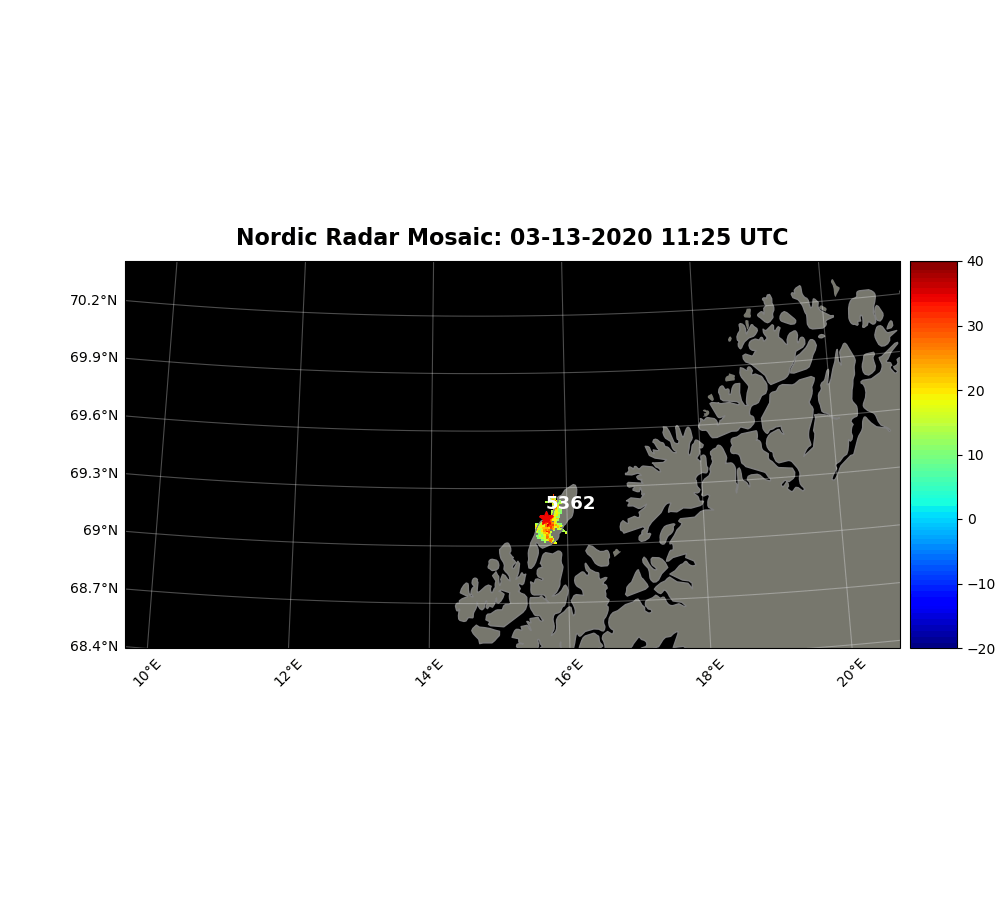

In [64]:
%%time
#Display image
display.Image('try.gif', width=700)

# longest track

In [69]:
cell_number1 = tracks['cell'].value_counts().keys()[0]
cell_number1

9970

In [70]:
mask_cell_661 = tobac.utils.mask_cell(Mask_ERF, cell_number1, tracks)
mask_cell_661

<iris 'Cube' of segmentation_mask / (1) (time: 301; -- : 400; -- : 400)>

In [71]:
convert_661 = xr.DataArray.from_iris(mask_cell_661)
convert_661

<xarray.DataArray 'segmentation_mask' (time: 301, dim_1: 400, dim_2: 400)>
[48160000 values with dtype=int32]
Coordinates:
  * time     (time) datetime64[ns] 2020-03-13T04:00:00 ... 2020-03-14T05:00:00
    lat      (dim_1, dim_2) float32 ...
    lon      (dim_1, dim_2) float32 ...
Dimensions without coordinates: dim_1, dim_2
Attributes:
    long_name:    segmentation_mask
    Conventions:  CF-1.7

In [72]:
# lt = tracks[tracks['cell'] == cell_number1].reset_index(drop=False)
# lt

lt = tracks[tracks['cell'] == cell_number1]
lt

,frame,idx,hdim_1,hdim_2,num,threshold_value,feature,time,timestr,projection_y_coordinate,projection_x_coordinate,latitude,longitude,cell,time_cell,distance,mean dBZ,max dBZ,area($km^2$),cloud_id
367,209,180,210.060010,276.480977,35,20,28542,2020-03-13 21:25:00,2020-03-13 21:25:00,-2.270060e+06,193480.977197,69.484436,14.871640,9970,0 days 00:20:00,49.799813,16.354603,41.619997,149.237950,64
346,205,173,195.258277,268.455212,15,20,28127,2020-03-13 21:05:00,2020-03-13 21:05:00,-2.255258e+06,185455.212252,69.624887,14.700990,9970,0 days 00:00:00,66.203867,16.413136,45.144854,198.980739,64
419,220,153,248.843093,293.413495,8,20,29617,2020-03-13 22:20:00,2020-03-13 22:20:00,-2.308843e+06,210413.495314,69.118833,15.207194,9970,0 days 01:15:00,19.079322,15.581884,43.128252,213.920004,64
390,213,165,227.091637,282.174275,17,20,28926,2020-03-13 21:45:00,2020-03-13 21:45:00,-2.287092e+06,199174.275078,69.325379,14.977119,9970,0 days 00:40:00,34.622493,16.673839,43.634195,133.323510,64
351,206,176,199.224253,270.962279,30,20,28224,2020-03-13 21:10:00,2020-03-13 21:10:00,-2.259224e+06,187962.278712,69.587006,14.755924,9970,0 days 00:05:00,61.544985,16.473165,44.135408,154.213300,64
385,212,151,222.599111,281.401057,9,20,28821,2020-03-13 21:40:00,2020-03-13 21:40:00,-2.282599e+06,198401.056900,69.366772,14.967603,9970,0 days 00:35:00,37.793890,16.975129,45.142555,112.429675,64
356,207,166,202.755134,272.899199,28,20,28322,2020-03-13 21:15:00,2020-03-13 21:15:00,-2.262755e+06,189899.198935,69.553491,14.797243,9970,0 days 00:10:00,57.601784,16.165405,40.612898,200.973221,64
415,218,168,242.000000,291.000000,1,20,29428,2020-03-13 22:10:00,2020-03-13 22:10:00,-2.302000e+06,208000.000000,69.182938,15.163010,9970,0 days 01:05:00,21.151389,15.813199,42.121100,216.903112,64
402,215,178,232.884545,285.685402,26,20,29129,2020-03-13 21:55:00,2020-03-13 21:55:00,-2.292885e+06,202685.401530,69.269999,15.051676,9970,0 days 00:50:00,28.810959,16.002105,42.123547,219.884647,64
379,211,152,218.339575,280.041901,20,20,28728,2020-03-13 21:35:00,2020-03-13 21:35:00,-2.278340e+06,197041.900555,69.406506,14.942919,9970,0 days 00:30:00,41.525446,16.685923,43.634195,95.514539,64


In [73]:
lt['frame'].values[:]

array([209, 205, 220, 213, 206, 212, 207, 218, 215, 211, 208, 217, 219,
       210, 216, 221, 214])

In [74]:
# %%time

# for i in range(182, 184+1):
# for idx, i in enumerate(np.unique(tracks['frame'].values[151:167+1])):
for idx, i in enumerate(lt['frame'].values[:]):

    ## center points and extent of map ###
    latA = 69.141281 #latitude of COMBLE site
    lonA = 15.684166-1 #longitude of COMBLE site -1
    xm, ym = 6,2.75 # extent from center point in lon and lat

    fig, ax = plt.subplots(1,1,figsize=(10, 9), subplot_kw={'projection': ccrs.Orthographic(lonA,latA)})

    # extent = (lonA-xm, lonA+xm, latA-ym, latA+ym) # define extent map
    extent = (lonA-xm+1, lonA+xm, latA-ym+2, latA+ym-1.5) # define extent map
    ax.set_extent(extent) # set extent of map
    ax.coastlines(resolution='10m', color='grey') # plot coastlines with high resolution: 10m
    ax.set_facecolor('black')
    ax.add_feature(cfeature.LAND, linewidth=1.5, alpha=0.5)
    
    # add grid lines
    gl = ax.gridlines(x_inline=False, alpha=0.3, color='white'); gl.bottom_labels=True; gl.left_labels=True
    gl.xformatter = LONGITUDE_FORMATTER; gl.yformatter = LATITUDE_FORMATTER
    gl.xlabel_style = {'rotation': 45}; gl.ylabel_style = {'color': 'black'}

    #change time to moth, day, year, hours and minutes
    dt = masked_values_to_xarray[idx]['time'].dt.strftime('%m-%d-%Y %H:%M').values  ### array 
    # dt = convert['time'].dt.strftime('%m-%d-%Y %H:%M').values  ### array 
    

#     #     # fill in the place where there is cloud with 1 and place with no cloud to be zero
    cloud = np.asarray(convert_661[i], dtype='float')
    # cloud = np.asarray(convert_660[i], dtype='float')
    # print(type(cloud))
    invalid_cloud = np.greater(cloud,0)
    cloud[invalid_cloud] = 1
    invalid_cloud1 = np.less(cloud,1)
    cloud[invalid_cloud1] = np.nan
    

    cs=ax.pcolormesh(convert_661['lon'],
                convert_661['lat'], 
                # cloud*equivalent_reflectivity_factor.values[i],
                cloud*equivalent_reflectivity_factor.values[i],
                cmap='jet',
                transform=ccrs.PlateCarree(),
                vmin=-20,
                vmax=40
                )
#     # display each id on cell
    frame=lt[lt['frame']==i]
    longi = frame['longitude'].values[0]
    lati = frame['latitude'].values[0]
    cloud_id = frame['cloud_id'].values[0]
    cell_id = frame['cell'].values[0]
    print(f"cell-id of {cell_id}, now id {cloud_id}")
    
    
    
    # check if area has value of nan
    if not math.isnan(frame['area($km^2$)'].values[0]):
        fontdict={'fontweight': 'extra bold'}
        ax.text(longi, lati+0.1, cell_id, transform=ccrs.PlateCarree(), fontsize=13, color='white', fontdict=fontdict)


    ax.plot(lonA+1,latA, color='red', marker='*', markersize = 10.5,transform=ccrs.PlateCarree()) # plot red star at location of Andenes
    # ax.plot(lonA,latA, color='red', marker='*', markersize = 20.5,transform=ccrs.PlateCarree()) # plot red star at location of Andenes
    ax.set_title(f"Nordic Radar Mosaic: {dt[i]} UTC", fontweight='bold', fontsize=16, pad=11)  # title of figure


    # Add a colorbar axis at the right of the graph
    # cbar_ax = fig.add_axes([0.85, 0.13, 0.047, 0.75]) #lbwh
    cbar_ax = fig.add_axes([0.91, 0.28, 0.047, 0.43]) #lbwh


    cbar=fig.colorbar(cs, cax=cbar_ax, orientation='vertical')
    cbar.set_label("Reflectivity Factor [dBZ]", fontsize = 15)
    
    
    fig.savefig(f'./long-track//{dt[i]}.png', dpi=100)
    plt.close()



#     dirr = sorted(os.listdir('./new//'))
#     if f'{dt[i]}.png' in dirr:
#         # print(f'{dt[i]}.png already exist')
#         pass
#         plt.close()
#     else:
#         fig.savefig(f'./new//{dt[i]}.png', dpi=100)
#         plt.close()
# print('\U0001f600\U0001f600\U0001f600\U0001f600EXECUTION DONE!!!\U0001f600\U0001f600\U0001f600\U0001f600')
# # gc.collect()

cell-id of 9970, now id 64
cell-id of 9970, now id 64
cell-id of 9970, now id 64
cell-id of 9970, now id 64
cell-id of 9970, now id 64
cell-id of 9970, now id 64
cell-id of 9970, now id 64
cell-id of 9970, now id 64
cell-id of 9970, now id 64
cell-id of 9970, now id 64
cell-id of 9970, now id 64
cell-id of 9970, now id 64
cell-id of 9970, now id 64
cell-id of 9970, now id 64
cell-id of 9970, now id 64
cell-id of 9970, now id 64
cell-id of 9970, now id 64


In [75]:
imgss = sorted(glob.glob("./long-track/*.png"))
imgss

['./long-track/03-13-2020 21:05.png',
 './long-track/03-13-2020 21:10.png',
 './long-track/03-13-2020 21:15.png',
 './long-track/03-13-2020 21:20.png',
 './long-track/03-13-2020 21:25.png',
 './long-track/03-13-2020 21:30.png',
 './long-track/03-13-2020 21:35.png',
 './long-track/03-13-2020 21:40.png',
 './long-track/03-13-2020 21:45.png',
 './long-track/03-13-2020 21:50.png',
 './long-track/03-13-2020 21:55.png',
 './long-track/03-13-2020 22:00.png',
 './long-track/03-13-2020 22:05.png',
 './long-track/03-13-2020 22:10.png',
 './long-track/03-13-2020 22:15.png',
 './long-track/03-13-2020 22:20.png',
 './long-track/03-13-2020 22:25.png']

In [76]:
%%time
# import glob
# Build GIF
imgs = sorted(glob.glob("./long-track/*.png"))
with imageio.get_writer('long-try.gif', mode='I', duration=0.7) as writer:
    for filename in imgs:
        image = imageio.v2.imread(filename)
        writer.append_data(image)

CPU times: user 1.18 s, sys: 5.9 ms, total: 1.19 s
Wall time: 1.24 s


CPU times: user 0 ns, sys: 327 µs, total: 327 µs
Wall time: 332 µs


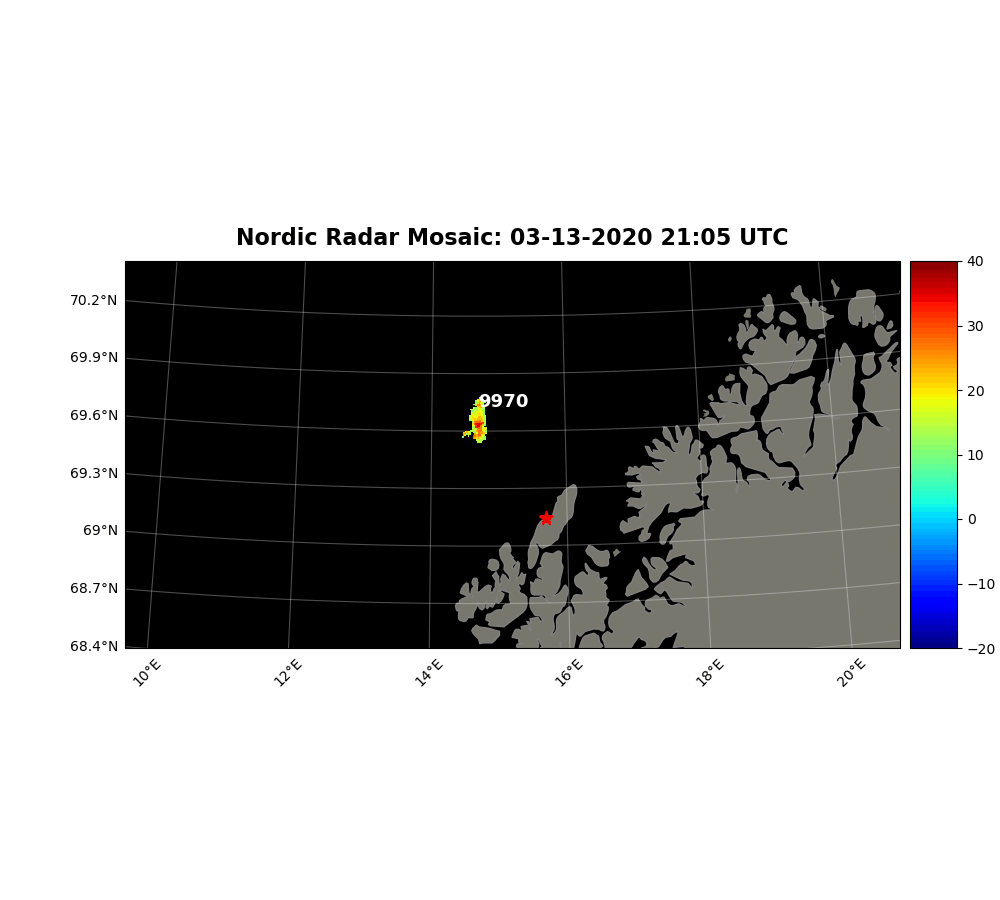

In [77]:
%%time
#Display image
display.Image('long-try.gif', width=700)

# for all cells

In [90]:
idx = np.unique(tracks['cell'].values)
idx

array([  300,   484,   527,   975,  1075,  2678,  2962,  3017,  3192,
        3275,  3580,  3855,  3892,  3943,  4023,  4094,  4276,  4293,
        4401,  4520,  4657,  4744,  4838,  4964,  4980,  5004,  5362,
        5572,  5668,  5872,  5903,  6065,  6140,  6334,  6479,  6501,
        6514,  6722,  7320,  7556,  7727,  7797,  7803,  7864,  7909,
        7963,  8223,  8255,  8257,  8463,  8630,  8694,  9141,  9168,
        9355,  9359,  9522,  9583,  9664,  9696,  9835,  9934,  9969,
        9970,  9974, 10074, 10158, 10218, 10371, 10759, 10791, 10812,
       12209])

In [91]:
for i, value in enumerate(idx):
    all_cells = tracks[tracks['cell'] == idx[i]]
    # all_cells

In [80]:
len(masked_values_to_xarray)
# for i in tracks['frame']:
#     print(i)

73

In [73]:
convert_alls = []
for ii, v in enumerate(idx):
    # mask in iris cube
    mask_cell_all = tobac.utils.mask_cell(Mask_ERF, v, tracks)
    # convert to xarray dataarray
    convert_all = xr.DataArray.from_iris(mask_cell_all)
    convert_alls.append(convert_all)

In [74]:
convert_660

<xarray.DataArray 'segmentation_mask' (time: 301, dim_1: 400, dim_2: 400)>
[48160000 values with dtype=int32]
Coordinates:
  * time     (time) datetime64[ns] 2020-03-13T04:00:00 ... 2020-03-14T05:00:00
    lat      (dim_1, dim_2) float32 ...
    lon      (dim_1, dim_2) float32 ...
Dimensions without coordinates: dim_1, dim_2
Attributes:
    long_name:    segmentation_mask
    Conventions:  CF-1.7

In [75]:
convert_alls[72]

<xarray.DataArray 'segmentation_mask' (time: 301, dim_1: 400, dim_2: 400)>
[48160000 values with dtype=int32]
Coordinates:
  * time     (time) datetime64[ns] 2020-03-13T04:00:00 ... 2020-03-14T05:00:00
    lat      (dim_1, dim_2) float32 ...
    lon      (dim_1, dim_2) float32 ...
Dimensions without coordinates: dim_1, dim_2
Attributes:
    long_name:    segmentation_mask
    Conventions:  CF-1.7

In [76]:
# masked_values_to_xarray[39]

In [77]:
# # %%time

# for i in range(10, 18+1):
# # for i in range(0, 20+1):

#     ## center points and extent of map ###
#     latA = 69.141281 #latitude of COMBLE site
#     lonA = 15.684166-1 #longitude of COMBLE site -1
#     xm, ym = 6,2.75 # extent from center point in lon and lat

#     fig, ax = plt.subplots(1,1,figsize=(10,9),subplot_kw={'projection': ccrs.Orthographic(lonA,latA)})

#     extent = (lonA-xm, lonA+xm, latA-ym, latA+ym) # define extent map
#     ax.set_extent(extent) # set extent of map
#     ax.coastlines(resolution='10m') # plot coastlines with high resolution: 10m


    
    
    
#     #change time to moth, day, year, hours and minutes
#     dt = masked_values_to_xarray[1]['time'].dt.strftime('%m-%d-%Y %H:%M').values  ### array 
#     # dt = convert['time'].dt.strftime('%m-%d-%Y %H:%M').values  ### array 
    

# #     #     # fill in the place where there is cloud with 1 and place with no cloud to be zero
#     # cloud = np.asarray(convert_660[i], dtype='float')
#     cloud = np.asarray(convert_alls[0][i], dtype='float')
#     invalid_cloud = np.greater(cloud,0)
#     cloud[invalid_cloud] = 1
#     invalid_cloud1 = np.less(cloud,1)
#     cloud[invalid_cloud1] = np.nan
    

#     cs=ax.pcolormesh(convert_alls[0]['lon'],
#                 convert_alls[0]['lat'], 
#                 # cloud*equivalent_reflectivity_factor.values[i],
#                 cloud*equivalent_reflectivity_factor.values[i],
#                 cmap='jet',
#                 transform=ccrs.PlateCarree(),
#                 vmin=-20,
#                 vmax=40
#                 )

#     ax.plot(lonA+1,latA, color='red', marker='*', markersize = 10.5,transform=ccrs.PlateCarree()) # plot red star at location of Andenes
#     # ax.plot(lonA,latA, color='red', marker='*', markersize = 20.5,transform=ccrs.PlateCarree()) # plot red star at location of Andenes
#     ax.set_title(f"Nordic Radar Mosaic: {dt[i]} UTC", fontweight='bold', fontsize=16, pad=11)  # title of figure


#     # Add a colorbar axis at the right of the graph
#     cbar_ax = fig.add_axes([0.85, 0.13, 0.047, 0.75]) #lbwh


#     cbar=fig.colorbar(cs, cax=cbar_ax, orientation='vertical')
#     cbar.set_label("Reflectivity Factor [dBZ]", fontsize = 15)
    
#     fig.savefig(f'./bb//{dt[i]}.png', dpi=100)
#     plt.close()



# # #     dirr = sorted(os.listdir('./mod-images//'))
# # #     if f'{dt[i]}.png' in dirr:
# # #         # print(f'{dt[i]}.png already exist')
# # #         pass
# # #         plt.close()
# # #     else:
# # #         fig.savefig(f'./mod-images//{dt[i]}.png', dpi=100)
# # #         plt.close()
# # print('\U0001f600\U0001f600\U0001f600\U0001f600EXECUTION DONE!!!\U0001f600\U0001f600\U0001f600\U0001f600')
# # gc.collect()

In [78]:
len(tracks['frame'].values[:])

452

In [79]:
tracks['frame'].values

array([  2,   3,   4,   5,   4,   5,   6,   9,   8,  10,   6,   5,   7,
        12,  13,  14,  15,  16,  17,  22,  28,  27,  26,  25,  23,  21,
        24,  19,  18,  17,  16,  15,  14,  20,  48,  47,  45,  44,  46,
        42,  41,  40,  39,  43,  45,  46,  47,  48,  49,  46,  47,  48,
        49,  52,  53,  50,  51,  55,  53,  54,  52,  51,  65,  64,  62,
        61,  63,  59,  58,  56,  60,  57,  60,  61,  62,  63,  68,  66,
        69,  65,  70,  67,  64,  63,  62,  61,  62,  64,  63,  67,  68,
        66,  65,  64,  67,  65,  68,  66,  72,  71,  70,  69,  70,  69,
        71,  75,  72,  73,  74,  74,  71,  73,  72,  75,  76,  81,  80,
        79,  83,  84,  82,  78,  74,  75,  73,  76,  77,  76,  77,  79,
        78,  77,  78,  79,  79,  81,  80,  82,  83,  84,  93,  92,  91,
        90,  89,  88,  87,  86,  85,  84,  83,  82,  85,  84,  83,  96,
        95,  94,  93,  91,  90,  89,  92,  97,  93,  94,  95,  96,  94,
        95,  96,  99, 100,  98,  99, 100,  98, 107, 106, 105, 10

In [60]:
# b = tracks['frame'].value_counts()
# for k, v in b.items():
#     if v > 1:
#         pass
        

In [ ]:
%%time
# loop_over = tracks['frame'].values[:8]
loop_over = tracks['frame'].values[:]
for i in loop_over:
    

    ## center points and extent of map ###
    latA = 69.141281 #latitude of COMBLE site
    lonA = 15.684166-1 #longitude of COMBLE site -1
    xm, ym = 6,2.75 # extent from center point in lon and lat

    fig, ax = plt.subplots(1,1,figsize=(10,9),subplot_kw={'projection': ccrs.Orthographic(lonA,latA)})

    extent = (lonA-xm, lonA+xm, latA-ym, latA+ym) # define extent map
    ax.set_extent(extent) # set extent of map
    ax.coastlines(resolution='10m', color='grey') # plot coastlines with high resolution: 10m
    ax.set_facecolor('black')
    # ax.add_feature(cfeature.OCEAN)

    

    #############################
    for j in range(0, len(idx)):
    
    
        #change time to moth, day, year, hours and minutes
        dt = masked_values_to_xarray[j]['time'].dt.strftime('%m-%d-%Y %H:%M').values  ### array 
        # dt = convert['time'].dt.strftime('%m-%d-%Y %H:%M').values  ### array 


        #  # fill in the place where there is cloud with 1 and place with no cloud to be zero
        # cloud = np.asarray(convert_660[i], dtype='float')
        cloud = np.asarray(convert_alls[j][i], dtype='float')
        invalid_cloud = np.greater(cloud,0)
        cloud[invalid_cloud] = 1
        invalid_cloud1 = np.less(cloud,1)
        cloud[invalid_cloud1] = np.nan
        
        
        cs=ax.pcolormesh(convert_alls[j]['lon'],
                    convert_alls[j]['lat'], 
                    # cloud*equivalent_reflectivity_factor.values[i],
                    cloud*equivalent_reflectivity_factor.values[i],
                    cmap='jet',
                    transform=ccrs.PlateCarree(),
                    vmin=-20,
                    vmax=40
                    )
    
        # display each id on cell
        frame=tracks[tracks['frame']==i]
        longi = frame['longitude'].values[0]
        lati = frame['latitude'].values[0]
        cloud_id = frame['cloud_id'].values[0]
        cell_id = frame['cell'].values[0]
        # print(f"cell-id of {cell_id}, now id {cloud_id}")

        ####################
        
#         if (len(frame['frame'].values) > 1) and (not math.isnan(frame['area($km^2$)'].values[0])):
#             fontdict={'fontweight': 'extra bold'}
#             ax.text(longi[i], lati[i]+0.1, cloud_id, transform=ccrs.PlateCarree(), fontsize=13, color='black', fontdict=fontdict)
#         elif (len(frame['frame'].values) <= 1) and (not math.isnan(frame['area($km^2$)'].values[0])):
#             fontdict={'fontweight': 'extra bold'}
#             ax.text(longi, lati+0.1, cell_id, transform=ccrs.PlateCarree(), fontsize=13, color='black', fontdict=fontdict)
#         else:
#             print('None')


       



    

#     # check if area has value of nan
        if not math.isnan(frame['area($km^2$)'].values[0]):
            fontdict={'fontweight': 'extra bold'}
            ax.text(longi, lati+0.1, cloud_id, transform=ccrs.PlateCarree(), fontsize=13, color='white', fontdict=fontdict)


    ax.plot(lonA+1,latA, color='red', marker='*', markersize = 10.5,transform=ccrs.PlateCarree()) # plot red star at location of Andenes
    # ax.plot(lonA,latA, color='red', marker='*', markersize = 20.5,transform=ccrs.PlateCarree()) # plot red star at location of Andenes
    ax.set_title(f"Nordic Radar Mosaic: {dt[i]} UTC", fontweight='bold', fontsize=16, pad=11)  # title of figure


    # Add a colorbar axis at the right of the graph
    cbar_ax = fig.add_axes([0.85, 0.13, 0.047, 0.75]) #lbwh


    cbar=fig.colorbar(cs, cax=cbar_ax, orientation='vertical')
    cbar.set_label("Reflectivity Factor [dBZ]", fontsize = 15)
    
    
#     fig.savefig(f'./big//{dt[i]}.png', dpi=100)
#     plt.close()



    dirr = sorted(os.listdir('./big//'))
    if f'{dt[i]}.png' in dirr:
        # print(f'{dt[i]}.png already exist')
        pass
        plt.close()
    else:
        fig.savefig(f'./big//{dt[i]}.png', dpi=300)
        plt.close()
print('\U0001f600\U0001f600\U0001f600\U0001f600EXECUTION DONE!!!\U0001f600\U0001f600\U0001f600\U0001f600')
# gc.collect()

In [62]:
# # %%time

# # for i in range(10, 18+1):
# # for i in tracks['frame'].values[:35]:
# for i in tracks['frame'].values[:]:
# # for i in range(0, 20+1):

#     ## center points and extent of map ###
#     latA = 69.141281 #latitude of COMBLE site
#     lonA = 15.684166-1 #longitude of COMBLE site -1
#     xm, ym = 6,2.75 # extent from center point in lon and lat

#     fig, ax = plt.subplots(1,1,figsize=(10,9),subplot_kw={'projection': ccrs.Orthographic(lonA,latA)})

#     extent = (lonA-xm, lonA+xm, latA-ym, latA+ym) # define extent map
#     ax.set_extent(extent) # set extent of map
#     ax.coastlines(resolution='10m', color='grey') # plot coastlines with high resolution: 10m
   
#     ax.set_facecolor('white')
#     ax.add_feature(cfeature.OCEAN)


#     #############################
#     for j in range(0, len(idx)):
    
#         #change time to moth, day, year, hours and minutes
#         dt = masked_values_to_xarray[j]['time'].dt.strftime('%m-%d-%Y %H:%M').values  ### array 
#         # dt = convert['time'].dt.strftime('%m-%d-%Y %H:%M').values  ### array 


#     #     #  # fill in the place where there is cloud with 1 and place with no cloud to be zero
#         # cloud = np.asarray(convert_660[i], dtype='float')
#         cloud = np.asarray(convert_alls[j][i], dtype='float')
#         invalid_cloud = np.greater(cloud,0)
#         cloud[invalid_cloud] = 1
#         invalid_cloud1 = np.less(cloud,1)
#         cloud[invalid_cloud1] = np.nan
        
#         # g=tracks[tracks['frame']==i]
#         # longi = g['longitude'].values[0]
#         # lati = g['latitude'].values[0]
#         # print(g['cell'].values[0])
#         # # print(g['longitude'].values[0])
#         # ax.text(longi, lati+0.1, g['cell'].values[0], transform=ccrs.PlateCarree(), fontsize=20, color='white')

    

#         cs=ax.pcolormesh(convert_alls[j]['lon'],
#                     convert_alls[j]['lat'], 
#                     # cloud*equivalent_reflectivity_factor.values[i],
#                     cloud*equivalent_reflectivity_factor.values[i],
#                     cmap='jet',
#                     transform=ccrs.PlateCarree(),
#                     vmin=-20,
#                     vmax=40
#                     )
#     # display each id on cell
#     frame=tracks[tracks['frame']==i]
#     longi = frame['longitude'].values[0]
#     lati = frame['latitude'].values[0]
#     cloud_id = frame['cloud_id'].values[0]
#     cell_id = frame['cell'].values[0]
#     print(f"cell-id of {cell_id}, now id {cloud_id}")
#     # print(g['longitude'].values[0])
#     # print(g['area($km^2$)'].values[0])
    
    
#     # check if area has value of nan
#     if not math.isnan(frame['area($km^2$)'].values[0]):
#         fontdict={'fontweight': 'extra bold'}
#         ax.text(longi, lati+0.1, cloud_id, transform=ccrs.PlateCarree(), fontsize=13, color='black', fontdict=fontdict)

#     # g=tracks[tracks['frame']==i]
#     # longi = g['longitude'].values[0]
#     # lati = g['latitude'].values[0]
#     # # print(g['cell'].values[0])
#     # fontdict={'fontweight': 'extra bold'}
#     # ax.text(longi, lati+0.1, g['cell'].values[0], transform=ccrs.PlateCarree(), fontsize=13, color='white', fontdict=fontdict)


#     ax.plot(lonA+1,latA, color='red', marker='*', markersize = 10.5,transform=ccrs.PlateCarree()) # plot red star at location of Andenes
#     # ax.plot(lonA,latA, color='red', marker='*', markersize = 20.5,transform=ccrs.PlateCarree()) # plot red star at location of Andenes
#     ax.set_title(f"Nordic Radar Mosaic: {dt[i]} UTC", fontweight='bold', fontsize=16, pad=11)  # title of figure


#     # Add a colorbar axis at the right of the graph
#     cbar_ax = fig.add_axes([0.85, 0.13, 0.047, 0.75]) #lbwh


#     cbar=fig.colorbar(cs, cax=cbar_ax, orientation='vertical')
#     cbar.set_label("Reflectivity Factor [dBZ]", fontsize = 15)
    
#     # # fig.savefig(f'./t10-images//frame{i}: {dt[i]}.png', dpi=300)
#     # fig.savefig(f'./t10-images//{dt[i]}.png', dpi=300)
#     # plt.close()
 



#     dirr = sorted(os.listdir('./t10-images//'))
#     if f'{dt[i]}.png' in dirr:
#         # print(f'{dt[i]}.png already exist')
#         pass
#         plt.close()
#     else:
#         fig.savefig(f'./t10-images//{dt[i]}.png', dpi=300)
#         plt.close()
# print('\U0001f600\U0001f600\U0001f600\U0001f600EXECUTION DONE!!!\U0001f600\U0001f600\U0001f600\U0001f600')
# # gc.collect()

In [63]:
# # %%time

# # for i in range(10, 18+1):
# for i in tracks['frame'].values[:35]:
# # for i in range(0, 20+1):

#     ## center points and extent of map ###
#     latA = 69.141281 #latitude of COMBLE site
#     lonA = 15.684166-1 #longitude of COMBLE site -1
#     xm, ym = 6,2.75 # extent from center point in lon and lat

#     fig, ax = plt.subplots(1,1,figsize=(10,9),subplot_kw={'projection': ccrs.Orthographic(lonA,latA)})

#     extent = (lonA-xm, lonA+xm, latA-ym, latA+ym) # define extent map
#     ax.set_extent(extent) # set extent of map
#     ax.coastlines(resolution='10m', color='grey') # plot coastlines with high resolution: 10m
#     ax.set_facecolor('black')
    

#     #############################
#     for j in range(0, 40):
    
#         #change time to moth, day, year, hours and minutes
#         dt = masked_values_to_xarray[j]['time'].dt.strftime('%m-%d-%Y %H:%M').values  ### array 
#         # dt = convert['time'].dt.strftime('%m-%d-%Y %H:%M').values  ### array 


#     #     #     # fill in the place where there is cloud with 1 and place with no cloud to be zero
#         # cloud = np.asarray(convert_660[i], dtype='float')
#         cloud = np.asarray(convert_alls[j][i], dtype='float')
#         invalid_cloud = np.greater(cloud,0)
#         cloud[invalid_cloud] = 1
#         invalid_cloud1 = np.less(cloud,1)
#         cloud[invalid_cloud1] = np.nan
        
#         # g=tracks[tracks['frame']==i]
#         # longi = g['longitude'].values[0]
#         # lati = g['latitude'].values[0]
#         # print(g['cell'].values[0])
#         # # print(g['longitude'].values[0])
#         # ax.text(longi, lati+0.1, g['cell'].values[0], transform=ccrs.PlateCarree(), fontsize=20, color='white')

    

#         cs=ax.pcolormesh(convert_alls[j]['lon'],
#                     convert_alls[j]['lat'], 
#                     # cloud*equivalent_reflectivity_factor.values[i],
#                     cloud*equivalent_reflectivity_factor.values[i],
#                     cmap='jet',
#                     transform=ccrs.PlateCarree(),
#                     vmin=-20,
#                     vmax=40
#                     )

#     g=tracks[tracks['frame']==i]
#     longi = g['longitude'].values[0]
#     lati = g['latitude'].values[0]
#     print(g['cell'].values[0])
#     fontdict={'fontweight': 'extra bold'}
#     ax.text(longi, lati+0.1, g['cell'].values[0], transform=ccrs.PlateCarree(), fontsize=13, color='white', fontdict=fontdict)


#     ax.plot(lonA+1,latA, color='red', marker='*', markersize = 10.5,transform=ccrs.PlateCarree()) # plot red star at location of Andenes
#     # ax.plot(lonA,latA, color='red', marker='*', markersize = 20.5,transform=ccrs.PlateCarree()) # plot red star at location of Andenes
#     ax.set_title(f"Nordic Radar Mosaic: {dt[i]} UTC", fontweight='bold', fontsize=16, pad=11)  # title of figure


#     # Add a colorbar axis at the right of the graph
#     cbar_ax = fig.add_axes([0.85, 0.13, 0.047, 0.75]) #lbwh


#     cbar=fig.colorbar(cs, cax=cbar_ax, orientation='vertical')
#     cbar.set_label("Reflectivity Factor [dBZ]", fontsize = 15)
    
#     fig.savefig(f'./bb//frame{i}: {dt[i]}.png', dpi=100)
#     plt.close()

In [6]:
imgs = sorted(glob.glob("./big/*.png"))
len(imgs)

156

In [7]:
%%time
# import glob
# Build GIF
imgs = sorted(glob.glob("./big/*.png"))
with imageio.get_writer('thress-10.gif', mode='I', duration=0.7) as writer:
    for filename in imgs:
        image = imageio.v2.imread(filename)
        writer.append_data(image)

CPU times: user 1min 47s, sys: 1.25 s, total: 1min 48s
Wall time: 1min 56s


CPU times: user 1.09 ms, sys: 5.98 ms, total: 7.07 ms
Wall time: 48.9 ms


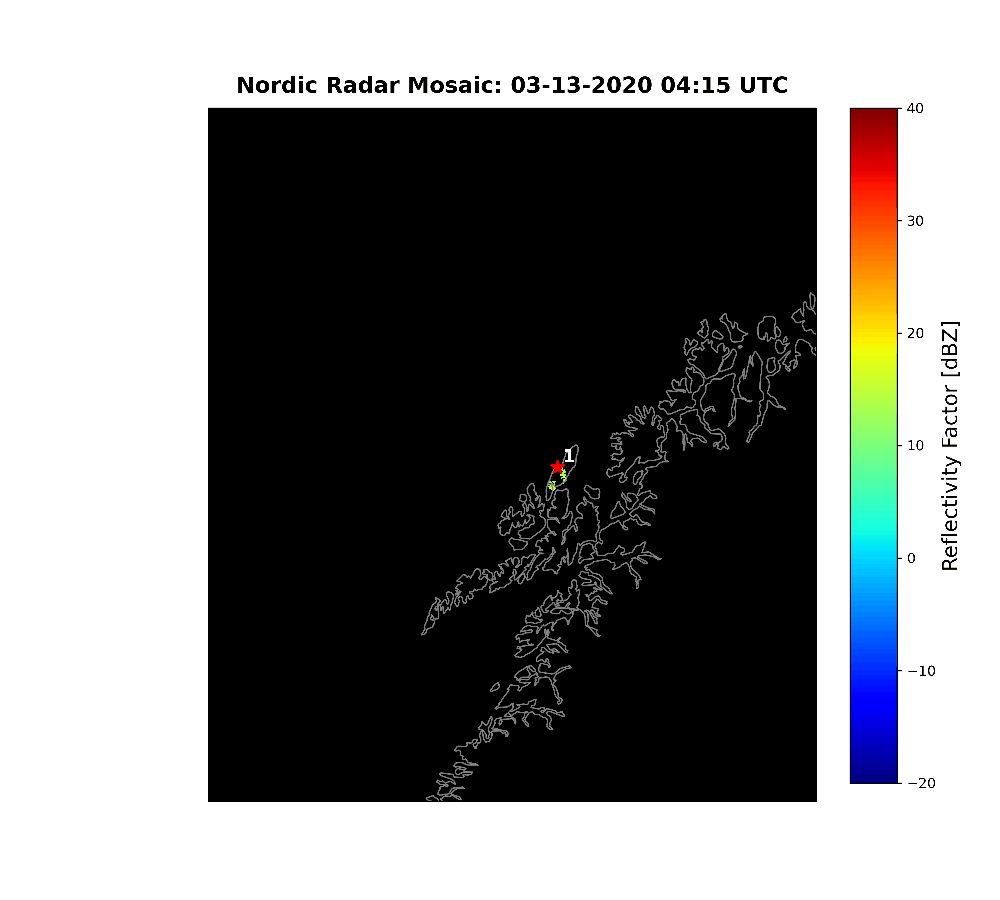

In [8]:
%%time
#Display image
display.Image('thress-10.gif', width=700)

In [ ]:


# for i in tracks['frame'].values:
for i in tracks['frame'].values[:14]:
# for i in range(0, 20+1):

    ## center points and extent of map ###
    latA = 69.141281 #latitude of COMBLE site
    lonA = 15.684166-1 #longitude of COMBLE site -1
    xm, ym = 6,2.75 # extent from center point in lon and lat

    fig, ax = plt.subplots(1,1,figsize=(10,9),subplot_kw={'projection': ccrs.Orthographic(lonA,latA)})

    extent = (lonA-xm, lonA+xm, latA-ym, latA+ym) # define extent map
    ax.set_extent(extent) # set extent of map
    ax.coastlines(resolution='10m') # plot coastlines with high resolution: 10m


    #change time to moth, day, year, hours and minutes
    dt = masked_values_to_xarray[i]['time'].dt.strftime('%m-%d-%Y %H:%M').values  ### array 
    # dt = convert['time'].dt.strftime('%m-%d-%Y %H:%M').values  ### array 


#     #     # fill in the place where there is cloud with 1 and place with no cloud to be zero
    cloud = np.asarray(convert_all[i], dtype='float')
    invalid_cloud = np.greater(cloud,0)
    cloud[invalid_cloud] = 1
    invalid_cloud1 = np.less(cloud,1)
    cloud[invalid_cloud1] = np.nan


    # cs=ax.pcolormesh(convert_all['lon'],
    #             convert_all['lat'], 
    #             # cloud*equivalent_reflectivity_factor.values[i],
    #             cloud*equivalent_reflectivity_factor.values[i],
    #             cmap='jet',
    #             transform=ccrs.PlateCarree(),
    #             vmin=-20,
    #             vmax=40
    #             )
    
    cs=ax.pcolormesh(convert_all['lon'],
                convert_all['lat'], 
                # cloud*equivalent_reflectivity_factor.values[i],
                cloud*equivalent_reflectivity_factor.values[i],
                cmap='jet',
                transform=ccrs.PlateCarree(),
                vmin=-20,
                vmax=40
                )

    ax.plot(lonA+1,latA, color='red', marker='*', markersize = 10.5,transform=ccrs.PlateCarree()) # plot red star at location of Andenes
    # ax.plot(lonA,latA, color='red', marker='*', markersize = 20.5,transform=ccrs.PlateCarree()) # plot red star at location of Andenes
    ax.set_title(f"Nordic Radar Mosaic: {dt[i]} UTC", fontweight='bold', fontsize=16, pad=11)  # title of figure


    # Add a colorbar axis at the right of the graph
    cbar_ax = fig.add_axes([0.85, 0.13, 0.047, 0.75]) #lbwh


    cbar=fig.colorbar(cs, cax=cbar_ax, orientation='vertical')
    cbar.set_label("Reflectivity Factor [dBZ]", fontsize = 15)

    fig.savefig(f'./news//{dt[i]}--{v}.png', dpi=100)
    plt.close()



# #     dirr = sorted(os.listdir('./mod-images//'))
# #     if f'{dt[i]}.png' in dirr:
# #         # print(f'{dt[i]}.png already exist')
# #         pass
# #         plt.close()
# #     else:
# #         fig.savefig(f'./mod-images//{dt[i]}.png', dpi=100)
# #         plt.close()
# print('\U0001f600\U0001f600\U0001f600\U0001f600EXECUTION DONE!!!\U0001f600\U0001f600\U0001f600\U0001f600')
# gc.collect()